## Моделирование молекулярной динамики

   - Система: ГЦК решётка $7\times7\times7$ частиц;
   - Постоянная решётки: $a = 1.75~\sigma $;
   - Потенциал взаимодействия: Леннард-Джонс;
   - Начальная температура: $T_i = 0.1~\varepsilon / k_B$;
   - Конечная температура: $T_f = 10^{-5}~\varepsilon / k_B$;
   - Скорости охлаждения: $v_1 = 0.02~\varepsilon / k_B\tau; v_2 = 0.001~\varepsilon / k_B\tau$;
   - Термостат: масштабирование скоростей;
   - Толщина сферического слоя (список Верле): $\Delta r_s = 0.3~\sigma $;
   - Временной шаг: $\Delta t = 0.005~\tau$;
   - Число "неравновесных" итераций: $40000$;
   - Равновесные характеристики системы рассчитывалась через каждые $2500$ шагов;
   - Число ансамблей $N=1000$;
   - Подсчёт состоял из $2N+499$ шагов: $500$ на уравновешивание системы при фиксированной температуре и $2N-1$ на усреднение по ансамблям (к первому ансамблю относятся шаги с $1$ по $N$ шаг, ко второму - с $2$ по $N+1$ и т. д.);
   - Функция радиального распределения вычислялась как среднее по времени за первые $N$ шагов;

#### Импорт необходимых библиотек

In [1]:
from copy import deepcopy
from datetime import datetime
import os
import sys

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, train_test_split, validation_curve
from sklearn.neighbors import KNeighborsRegressor, RadiusNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn import svm
from sklearn.metrics import mean_squared_error, mean_absolute_error

sys.path.append(os.path.dirname(sys.path[0]))

import scripts.constants as con
from scripts.postprocessing import PostProcessor, RegressionRDF

#### Настройки рисунков

In [2]:
FIGSIZE = (7, 7)
FONTSIZE = 14

plt.style.use('seaborn')
plt.rcParams['axes.labelpad'] = 0
plt.rcParams['lines.linewidth'] = 2
plt.rcParams['axes.linewidth'] = 2
plt.rcParams['figure.dpi'] = 300
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['figure.figsize'] = [i / 2.54 for i in (15, 15)]
plt.rcParams['mathtext.fontset'] = 'stix'
plt.rcParams['mathtext.it'] = 'Times New Roman'
plt.rcParams['xtick.labelsize'] = FONTSIZE
plt.rcParams['ytick.labelsize'] = FONTSIZE
plt.rcParams['legend.fontsize'] = FONTSIZE 
plt.rcParams['axes.titlesize'] = FONTSIZE
plt.rcParams['axes.labelsize'] = FONTSIZE
plt.rcParams['font.size'] = FONTSIZE

COLORS = (
    'black',
    'red',
    'green',
    'blue',
    'cyan',
    'magenta',
    'purple',
    'orange',
    'olive',
    'yellow',
    'brown',
    'pink',
    'gray',
    'lime',
    'slateblue',
    'crimson',
    'darkviolet',
    'sienna',
    'coral',
)


#### Путь к файлам с данными

In [3]:
CURRENT_DATA = '2021-07-01_cooling_various_hv'
PLOT_FILENAME_POSTFIX = 'cooling_various_hv'

In [4]:
PATH_TO_CURRENT_DATA = os.path.join(con.PATH_TO_DATA, CURRENT_DATA)
PATH_TO_CURRENT_DATA

'C:\\Users\\farhutdinov.a\\Documents\\Albert\\git_reps\\molecular_dynamics\\data\\2021-07-01_cooling_various_hv'

In [5]:
PATH_TO_CURRENT_PLOTS = os.path.join(con.PATH_TO_PLOTS, CURRENT_DATA)
PATH_TO_CURRENT_PLOTS

'C:\\Users\\farhutdinov.a\\Documents\\Albert\\git_reps\\molecular_dynamics\\plots\\2021-07-01_cooling_various_hv'

#### Пользовательские функции

In [6]:
def get_merged_data(
    old_data : pd.DataFrame, 
    data_filename_prefix : str, 
    merge_column_name : str, 
    old_column_name : str, 
    temperature : float, 
    columns : list = None,
):
    df = pd.read_csv(
        f'{data_filename_prefix}{temperature:.5f}.csv',
        sep=';',
    )
    if columns is not None:
        df = df[columns]
    merged_data = old_data.merge(
        right=df,
        how='outer',
        on=merge_column_name,
    )
    merged_data = merged_data.rename(columns={old_column_name: f'{temperature:.5f}'})
    return merged_data

In [7]:
def save_plot(filename):
    plt.savefig(
        os.path.join(PATH_TO_CURRENT_PLOTS, filename)
    )

#### Параметры системы, при которых были подчитаны функции радиального распределения, среднеквадратичные смещения и т.д.

In [8]:
setups = {}

for filename in os.listdir(PATH_TO_CURRENT_DATA)[::-1]:
    if filename.startswith('rdf'):
        parts = filename[:-4].split('_')
        setup = {
            'temperature': float(parts[2]), 
            'pressure': float(parts[4]) if 'P' in parts else None,
            'heating_velocity': float(parts[6]) if 'HV' in parts else None,

        }
        try:
            setups[round(setup['temperature'], 2)].append(setup)
        except KeyError:
            setups[round(setup['temperature'], 2)] = [setup]

for key, value in setups.items():
    setups[key] = list(sorted(value, key=lambda x: x['heating_velocity']))
            
del setups[0.95]
setups

{1.0: [{'temperature': 0.99962,
   'pressure': -2.18977,
   'heating_velocity': 0.0008},
  {'temperature': 0.9996, 'pressure': -2.18979, 'heating_velocity': 0.004},
  {'temperature': 0.99957, 'pressure': -2.18981, 'heating_velocity': 0.01},
  {'temperature': 0.99952, 'pressure': -2.18985, 'heating_velocity': 0.02},
  {'temperature': 0.99947, 'pressure': -2.18989, 'heating_velocity': 0.03},
  {'temperature': 0.99942, 'pressure': -2.18992, 'heating_velocity': 0.04},
  {'temperature': 0.99937, 'pressure': -2.18996, 'heating_velocity': 0.05},
  {'temperature': 0.99932, 'pressure': -2.19, 'heating_velocity': 0.06},
  {'temperature': 0.99927, 'pressure': -2.19003, 'heating_velocity': 0.07},
  {'temperature': 0.99922, 'pressure': -2.19007, 'heating_velocity': 0.08},
  {'temperature': 0.99917, 'pressure': -2.19011, 'heating_velocity': 0.09},
  {'temperature': 0.99912, 'pressure': -2.19015, 'heating_velocity': 0.1}],
 0.3: [{'temperature': 0.29988,
   'pressure': -2.7144,
   'heating_velocity':

#### Температуры, для которых функция радиального распределения предсказывается

In [9]:
test_temperatures = list(setups.keys())
test_heating_velocities = [item['heating_velocity'] for item in setups[test_temperatures[0]]][::2]
test_heating_velocities

[0.0008, 0.01, 0.03, 0.05, 0.07, 0.09]

#### Инициализация объекта для обработки данных и вывод таблицы значений функции радиального распределения

In [10]:
pp_dict = {
    key: PostProcessor(
        path_to_data=PATH_TO_CURRENT_DATA,
        path_to_plots=PATH_TO_CURRENT_PLOTS, 
        plot_filename_postfix=PLOT_FILENAME_POSTFIX,
        setups=value,
    )
    for key, value in setups.items()
}

pp_dict[0.25].rdf.data

,radius,setup_0,setup_1,setup_2,setup_3,setup_4,setup_5,setup_6,setup_7,setup_8,setup_9,setup_10,setup_11
0,0.01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
607,6.08,0.891024,0.903676,0.836818,0.895715,0.863006,0.833732,0.813764,0.931481,0.805141,0.826052,0.828581,0.824408
608,6.09,0.895660,0.919734,0.847119,0.895937,0.857317,0.831976,0.816143,0.943481,0.806912,0.818913,0.821647,0.822888
609,6.10,0.901210,0.938642,0.860094,0.897796,0.853017,0.833532,0.820273,0.954744,0.810575,0.815886,0.817424,0.823198
610,6.11,0.906412,0.958111,0.875239,0.899722,0.851900,0.838171,0.830556,0.965282,0.819890,0.813391,0.815967,0.825800


#### Графики функций радиального распределения $g(\textbf{r})$ при различных температурах

$$g(\textbf{r})=\dfrac{V}{N^2}\left<\sum_{i}{\sum_{j\ne i}{\delta(\textbf{r}-\textbf{r}_{ij})}}\right>$$

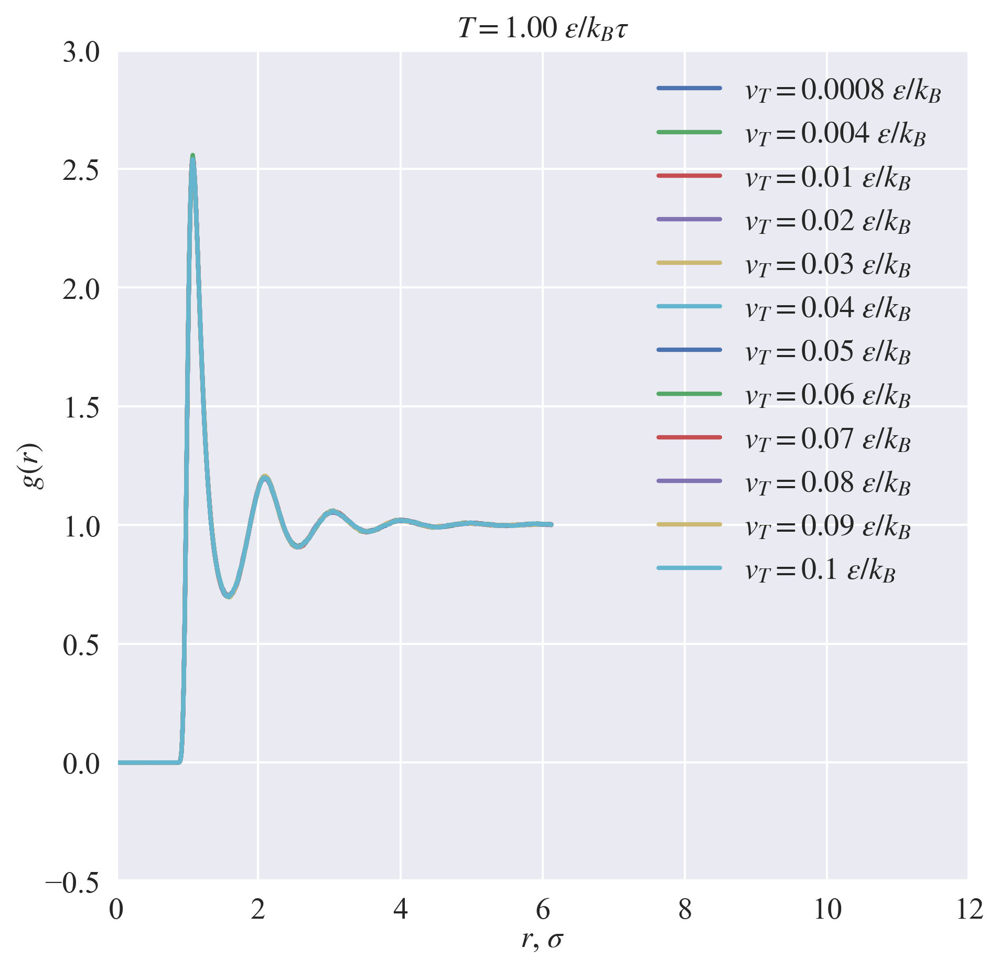

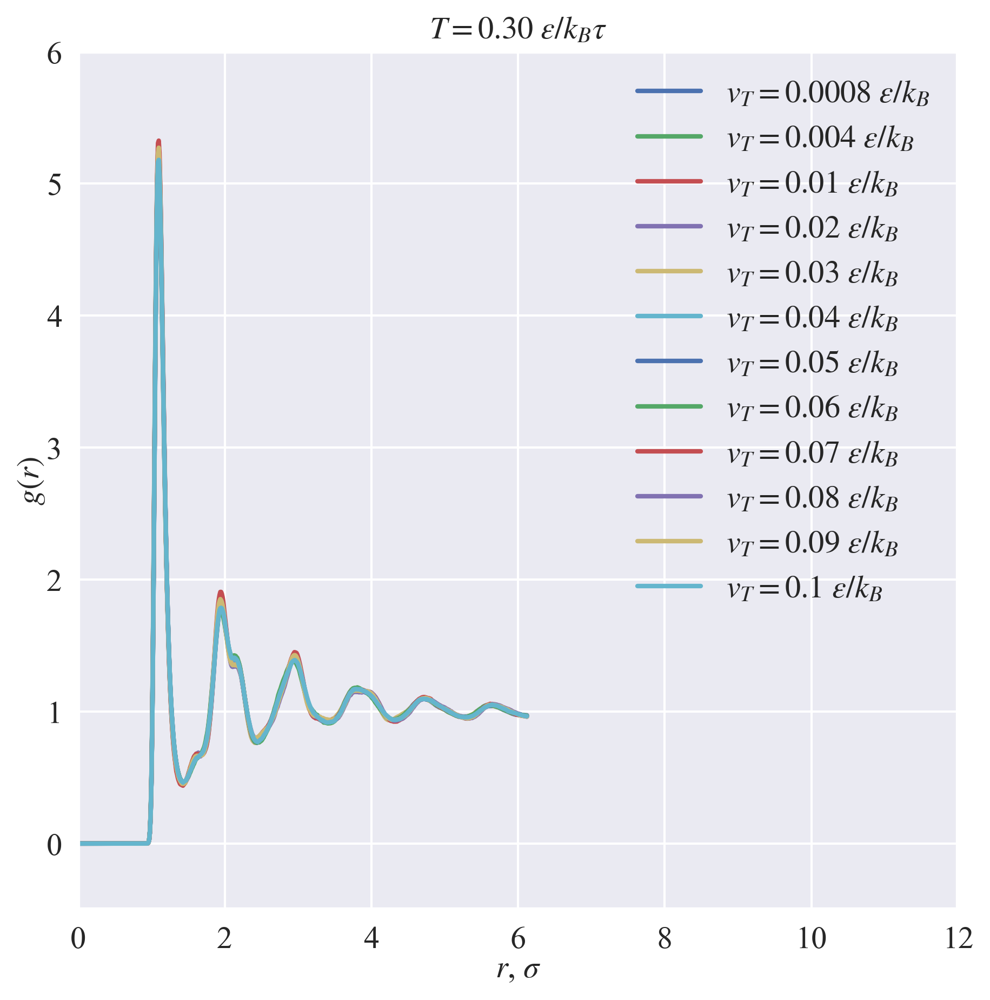

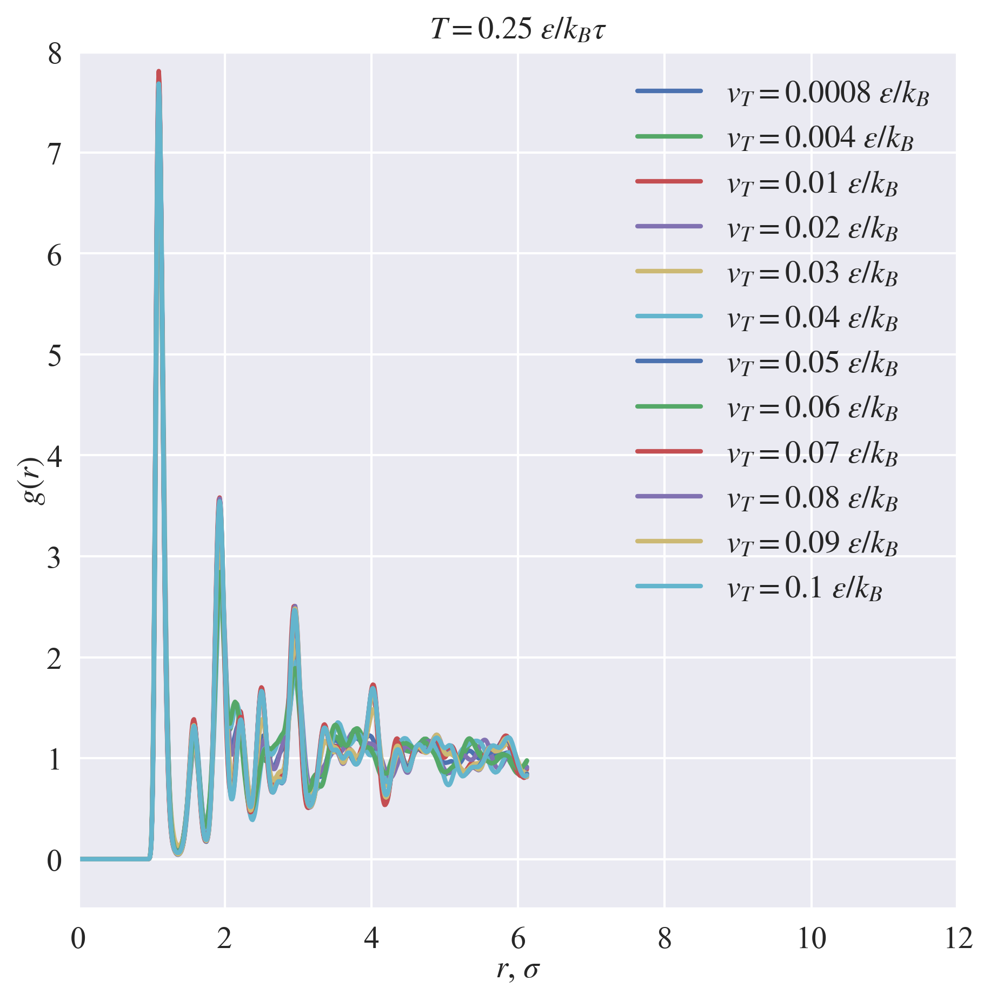

In [11]:
shifts = {
    1.0: 0.0, 
    0.95: 0.0, 
    0.3: 0.0, 
    0.25: 0.0, 
}
tops = {
    1.0: 3, 
    0.95: 3, 
    0.3: 6, 
    0.25: 8,
}
for temperature, pp in pp_dict.items():
    shift = shifts[temperature]
    limits = {
        'left': 0,
        'right': 12,
        'bottom': -0.5, 
        'top': tops[temperature],
    }
    shown = None
    
    fig, ax = plt.subplots(figsize=FIGSIZE)
    for i, setup in enumerate(pp.setups):
        if shown is not None and i not in shown:
            continue
        
        ax.plot(
            pp.rdf.data['radius'],
            pp.rdf.data[f'setup_{i}'] + shift * (len(pp.setups) - (i + 1)),
            label=fr'$v_T = {setup["heating_velocity"]}~\epsilon / k_B$'
        )
    ax.set_xlabel(r'$r$, $\sigma $')
    ax.set_ylabel('$g(r)$')
    ax.set_xlim(
        left=limits.get('left'),
        right=limits.get('right'),
    )
    ax.set_ylim(
        bottom=limits.get('bottom'),
        top=limits.get('top'),
    )
    ax.legend()
    ax.set_title(fr'$T = {temperature:.2f}~\varepsilon / k_B\tau$')
    pp.save_plot(
        filename=(
            f'rdf'
            f'_{pp.plot_filename_postfix}'
            f'_full_size_{temperature}.png'
        )
    )

#### Создаём таблицу со значениями RDF, где строка соответствует значению температуры $T$, а столбец - расстоянию $r$.

In [12]:
rr_dict = {}

for key, value in setups.items():
    rr_dict[key] = RegressionRDF(
        post_processor=pp_dict[key], 
        setups=value,
        test_temperatures=test_temperatures,
    )

rr_dict[0.25].rdf_table

radius,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.10,...,6.03,6.04,6.05,6.06,6.07,6.08,6.09,6.10,6.11,6.12
setup_11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.877579,0.862680,0.848902,0.836921,0.828458,0.824408,0.822888,0.823198,0.825800,0.830785
setup_10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.899026,0.881760,0.864684,0.848583,0.837297,0.828581,0.821647,0.817424,0.815967,0.816361
setup_9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.891896,0.874600,0.859388,0.845642,0.835071,0.826052,0.818913,0.815886,0.813391,0.813553
setup_8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.851599,0.839550,0.825636,0.815302,0.808936,0.805141,0.806912,0.810575,0.819890,0.831470
setup_7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.892334,0.896617,0.902659,0.911316,0.920192,0.931481,0.943481,0.954744,0.965282,0.977006
setup_6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.852361,0.840197,0.829818,0.820747,0.815930,0.813764,0.816143,0.820273,0.830556,0.843211
setup_5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.876413,0.863548,0.852410,0.842718,0.836758,0.833732,0.831976,0.833532,0.838171,0.846320
setup_4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.918566,0.905344,0.892549,0.880152,0.871318,0.863006,0.857317,0.853017,0.851900,0.850516
setup_3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.912431,0.907031,0.900998,0.896620,0.895887,0.895715,0.895937,0.897796,0.899722,0.904932
setup_2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.824922,0.823234,0.821949,0.824882,0.829061,0.836818,0.847119,0.860094,0.875239,0.891990


#### К каждому столбцу $g(v_T, r=r_i)$ применим алгоритм регрессии

In [13]:
regressors_lists = {temperature: [] for temperature, rr in rr_dict.items()}
scores_dicts = {
    temperature: {
        'linear': [],
        'k_neighbors_uniform': [],
        'k_neighbors_distance': [],
        'r_neighbors_uniform': [],
        'r_neighbors_distance': [],
        'support_vector_machine': [],
        'decision_tree': [],
        'gaussian_process': [],
    }
    for temperature, rr in rr_dict.items()
}

In [14]:
heating_velocities = {
    temperature: np.array([
        setups[temperature][value]['heating_velocity'] 
        for value 
        in rr.rdf_table.index.str[6:].values.astype(np.int32)
    ])
    for temperature, rr in rr_dict.items()
}
X = {temperature: x[:, np.newaxis] for temperature, x in heating_velocities.items()}

In [15]:
# for column in rr.rdf_table.columns:
#     y = rdf_table[column].values
#     param_range = np.arange(1, 10, 1)
#     if y.any():
#         train_scores, valid_scores = validation_curve(
#             estimator=KNeighborsRegressor(weights='distance'), 
#             X=X, 
#             y=y, 
#             param_name="n_neighbors", 
#             param_range=param_range, 
#             cv=39,
#             scoring='neg_mean_squared_error'
#         )
#         train_scores_mean = np.mean(train_scores, axis=1)
#         train_scores_std = np.std(train_scores, axis=1)
#         valid_scores_mean = np.mean(valid_scores, axis=1)
#         valid_scores_std = np.std(valid_scores, axis=1)
#         plt.plot(param_range, train_scores_mean, label='train_scores');
#         plt.plot(param_range, valid_scores_mean, label='valid_scores');
#         plt.title(f'r = {column}')
#         plt.legend();
#         plt.show();

In [16]:
for temperature, rr in rr_dict.items():
    for column in rr.rdf_table.columns:
        y = rr.rdf_table[column].values
        regressors = {
            'linear': LinearRegression(),
            'k_neighbors_uniform': KNeighborsRegressor(n_neighbors=3, weights='uniform'),
            'k_neighbors_distance': KNeighborsRegressor(n_neighbors=3, weights='distance'),
            'r_neighbors_uniform': RadiusNeighborsRegressor(radius=0.1, weights='uniform'),
            'r_neighbors_distance': RadiusNeighborsRegressor(radius=0.1, weights='distance'),
            'support_vector_machine': svm.SVR(),
            'decision_tree': DecisionTreeRegressor(),
            'gaussian_process': GaussianProcessRegressor(),
        }
        for key, value in regressors.items():
            score = cross_val_score(value, X[temperature], y, cv=12, scoring='neg_mean_squared_error').mean()
            scores_dicts[temperature][key].append(score)
            X_train, X_test, y_train, y_test = train_test_split(X[temperature], y, random_state=0, train_size=0.5)
            regressors[key].fit(X_train, y_train)

        regressors_lists[temperature].append(regressors)

    for key, value in scores_dicts[temperature].items():
        scores_dicts[temperature][key] = np.array(value)

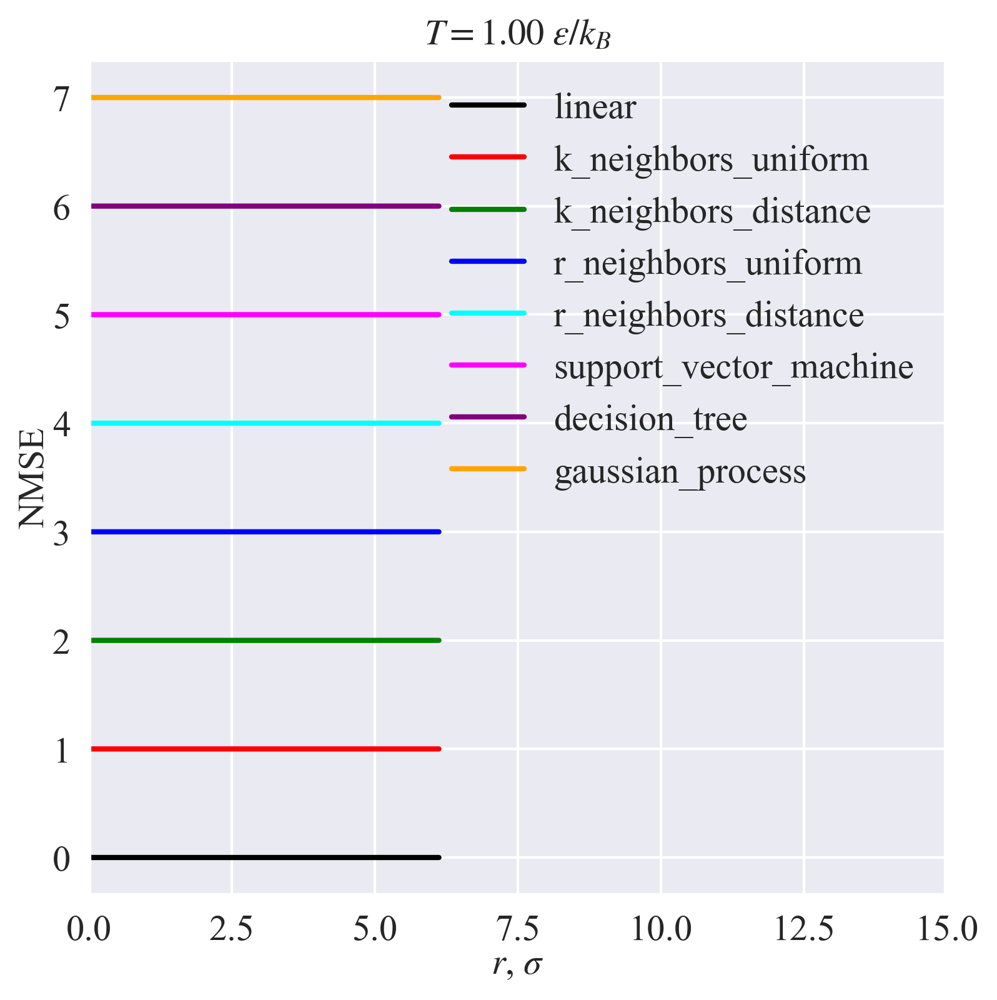

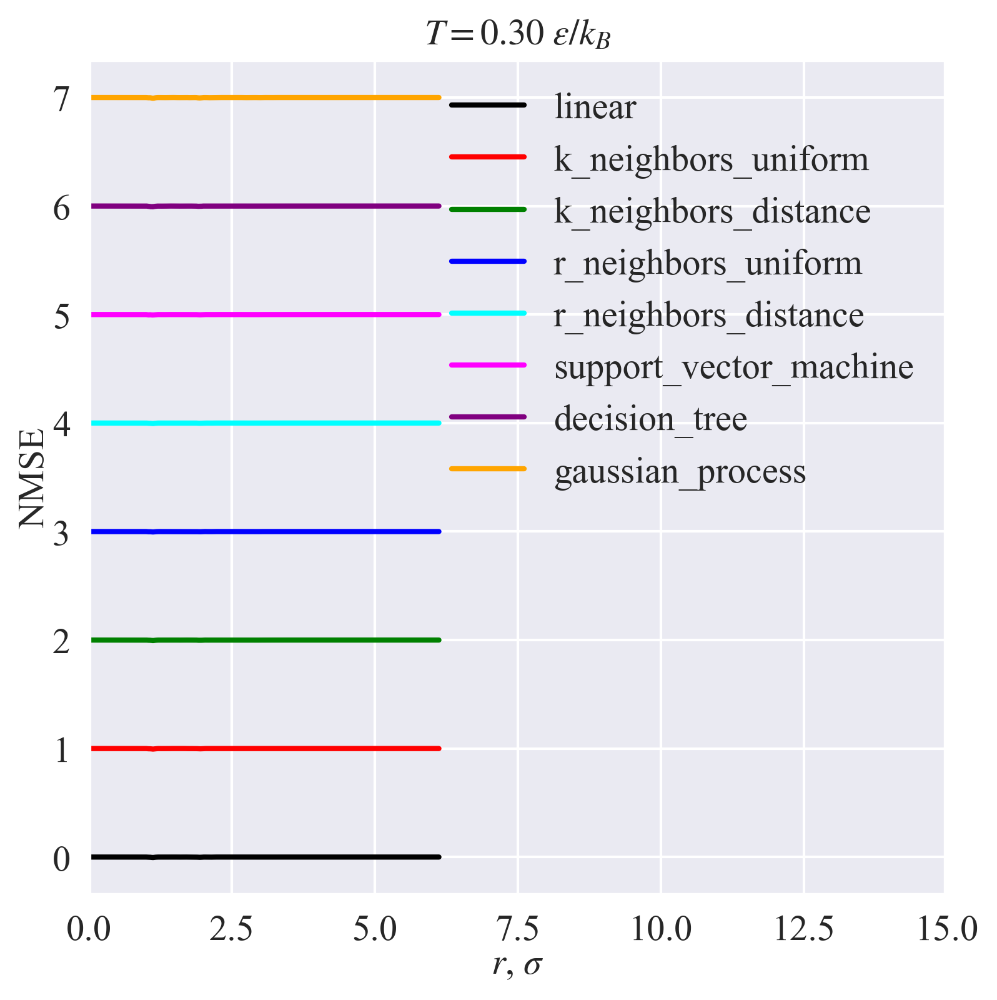

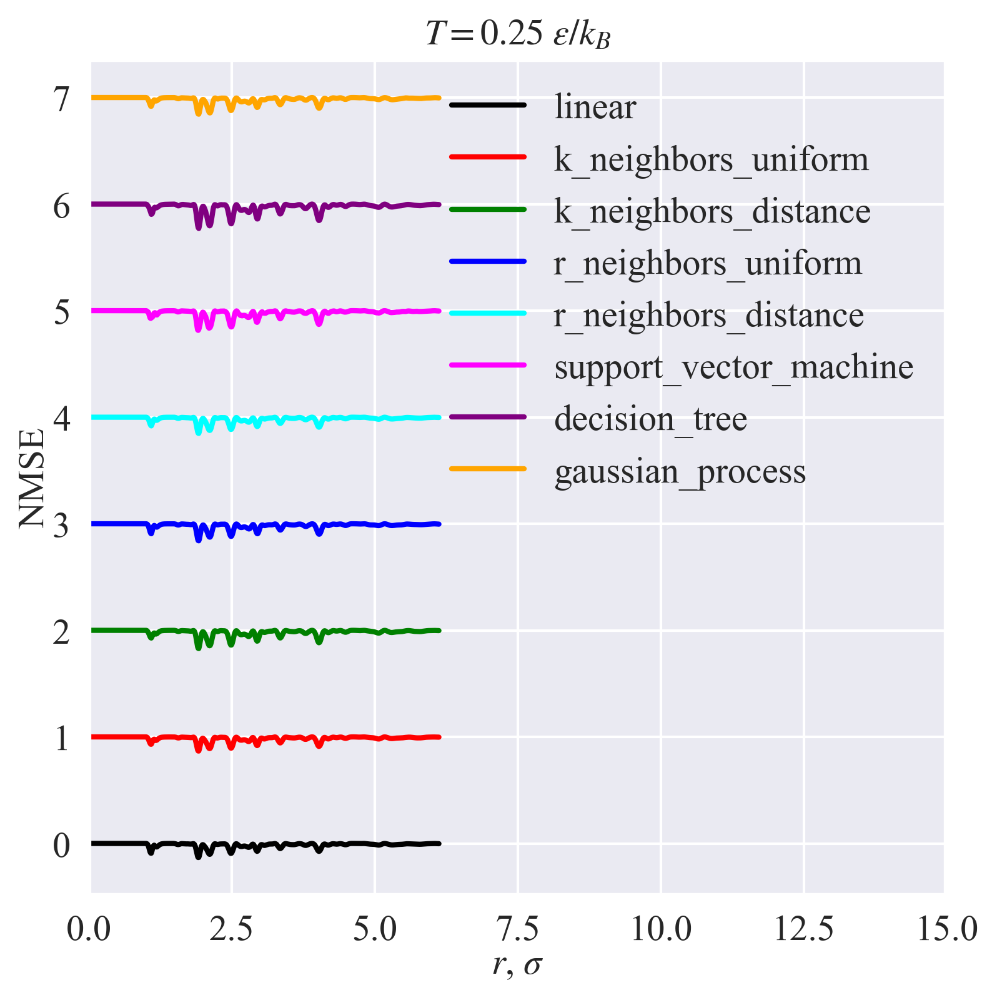

In [17]:
for temperature, rr in rr_dict.items():
    i = 0
    for key, value in scores_dicts[temperature].items():
        plt.plot(pp_dict[temperature].rdf.data['radius'], value + i, label=key, color=COLORS[i]);
        i += 1
    plt.legend();
    plt.xlim(
        left=0.0,
        right=15,
    );
    plt.ylim(
    #     top=0.01,
    #     bottom=-0.25,
    );
    plt.xlabel(r'$r$, $\sigma $');
    plt.ylabel('NMSE');
    plt.title(fr'$T = {temperature:.2f}~\varepsilon / k_B$');
    save_plot(f'mse_after_cv_{temperature}.png');
    plt.show();

In [18]:
# scores_dicts

In [19]:
# regressors_lists

In [20]:
predicted_heating_velocities = np.array(test_heating_velocities)
X_predicted = predicted_heating_velocities[:, np.newaxis]

predicted_rdf_points = {}
for temperature, rr in rr_dict.items():
    predicted_rdf_points[temperature] = {
        regressor: {key: [] for key in predicted_heating_velocities}
        for regressor in scores_dicts[temperature].keys()
    }
    
X_predicted

array([[0.0008],
       [0.01  ],
       [0.03  ],
       [0.05  ],
       [0.07  ],
       [0.09  ]])

In [21]:
for temperature, rr in rr_dict.items():
    for item in regressors_lists[temperature]:
        for key, value in item.items():
            predicted_data = value.predict(X_predicted)
            for _key, _ in predicted_rdf_points[temperature][key].items():
                predicted_rdf_points[temperature][key][_key].append(
                    predicted_data[np.where(test_heating_velocities == _key)][0]
                )

    for key, value in predicted_rdf_points[temperature].items():
        for _key, _value in value.items():
            predicted_rdf_points[temperature][key][_key] = np.array(_value)
            
predicted_rdf_points

{1.0: {'linear': {0.0008: array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
          0.000

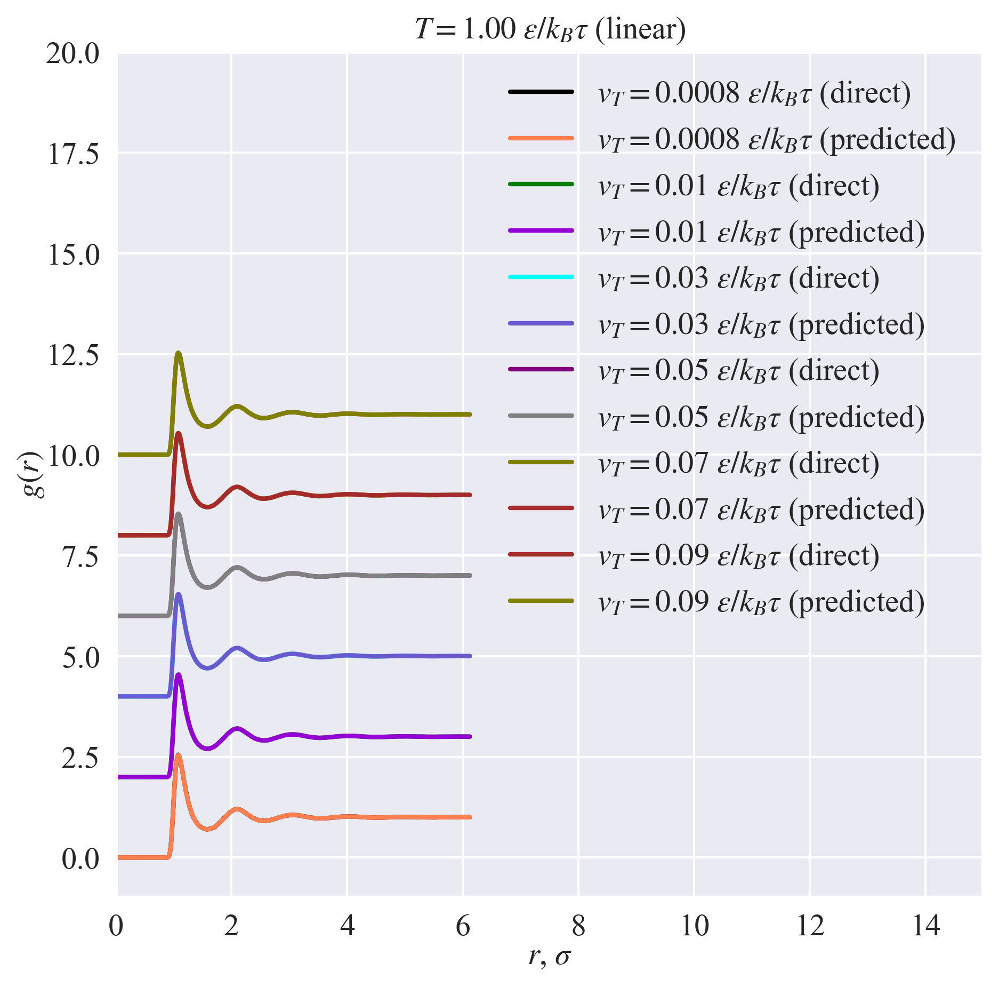

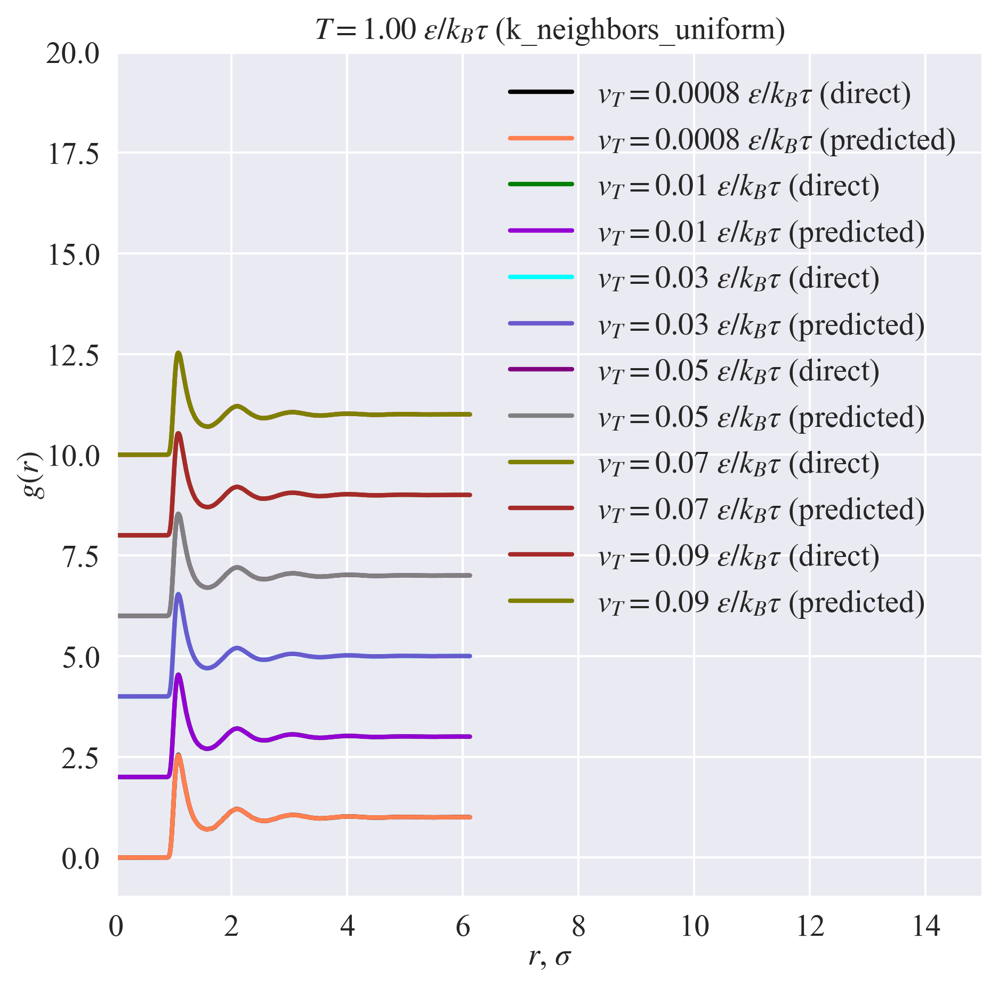

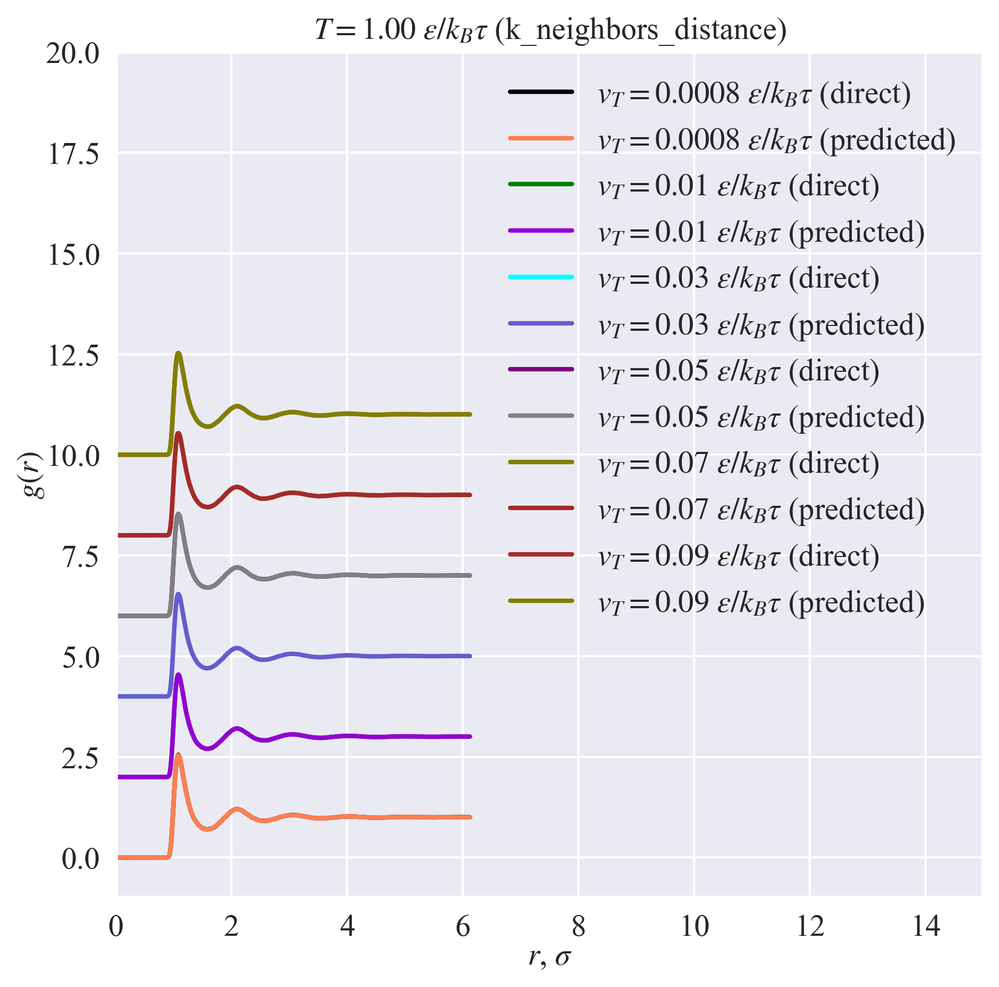

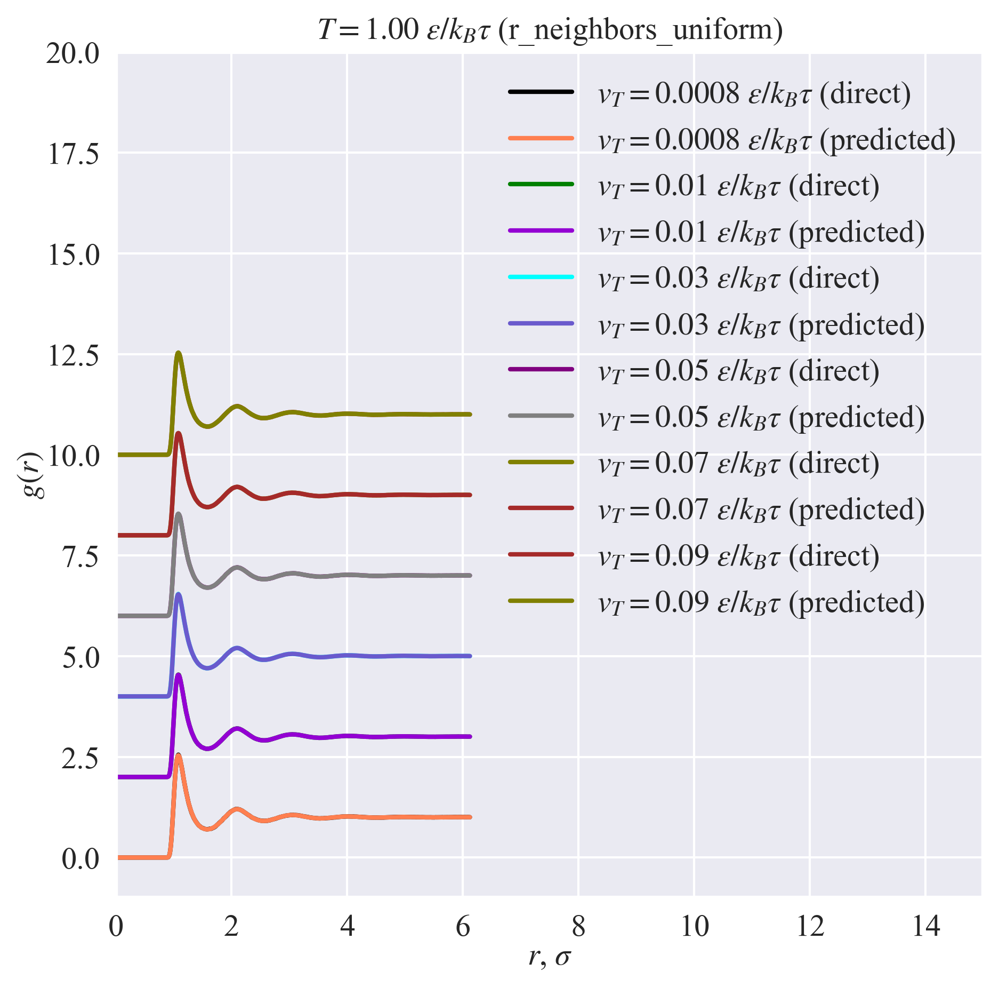

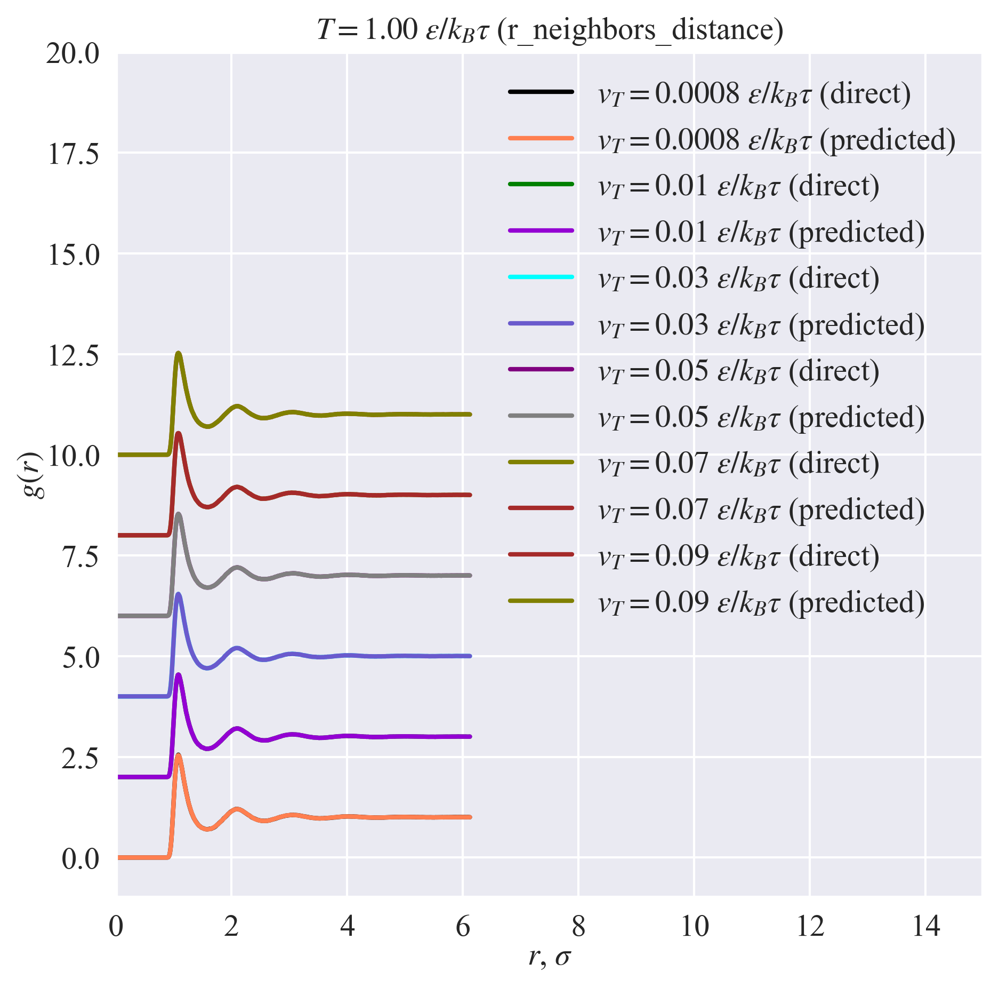

...

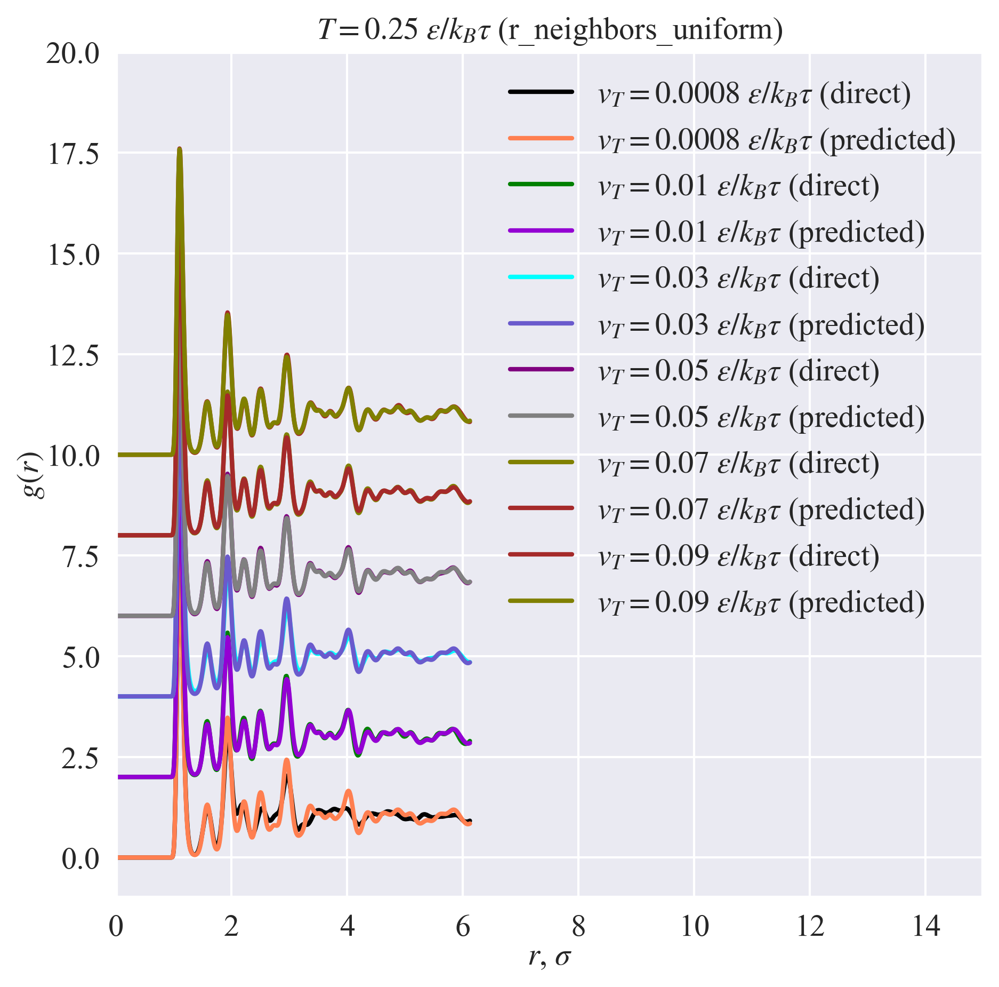

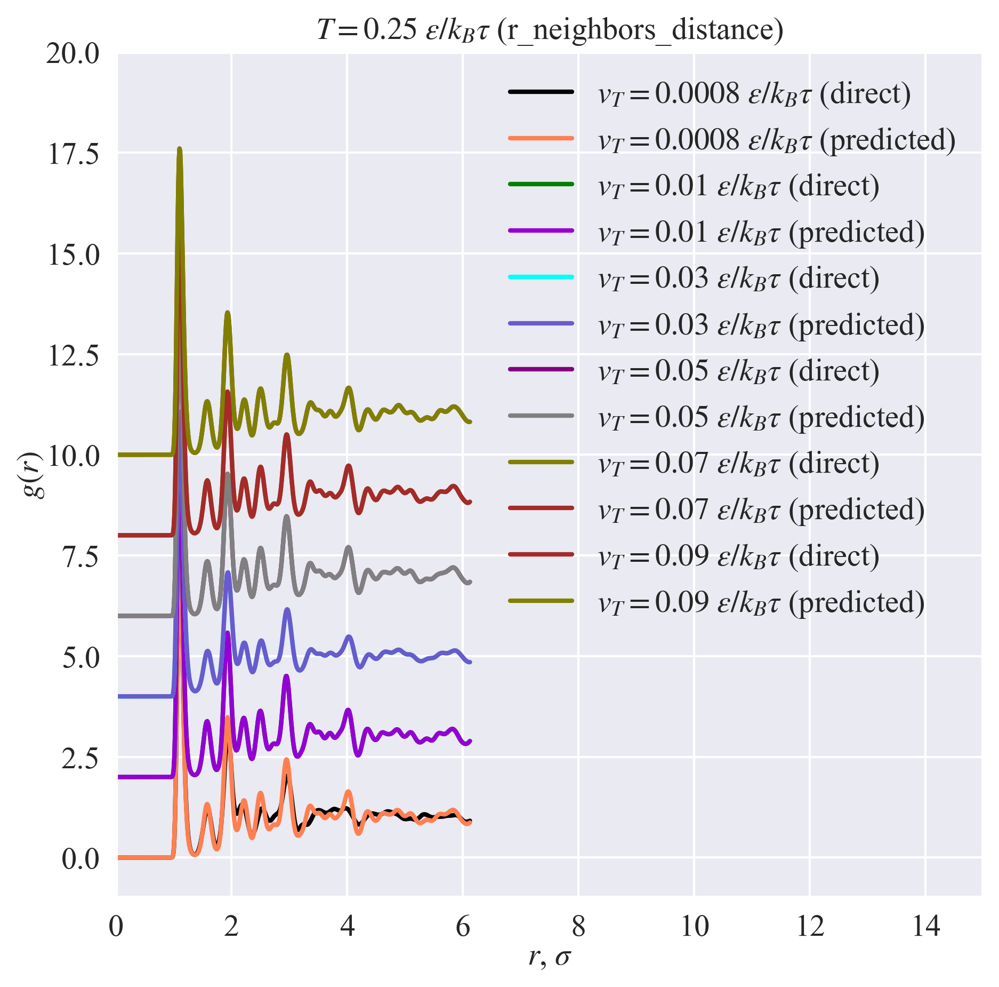

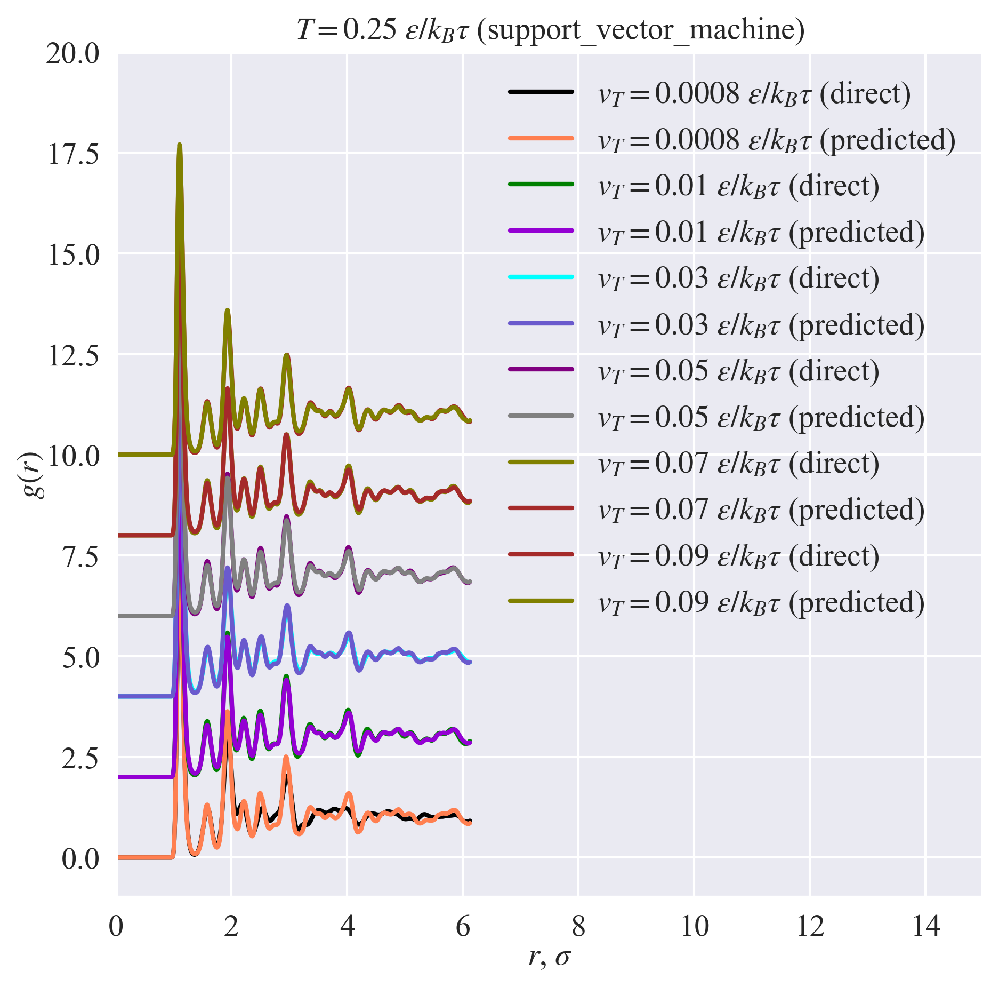

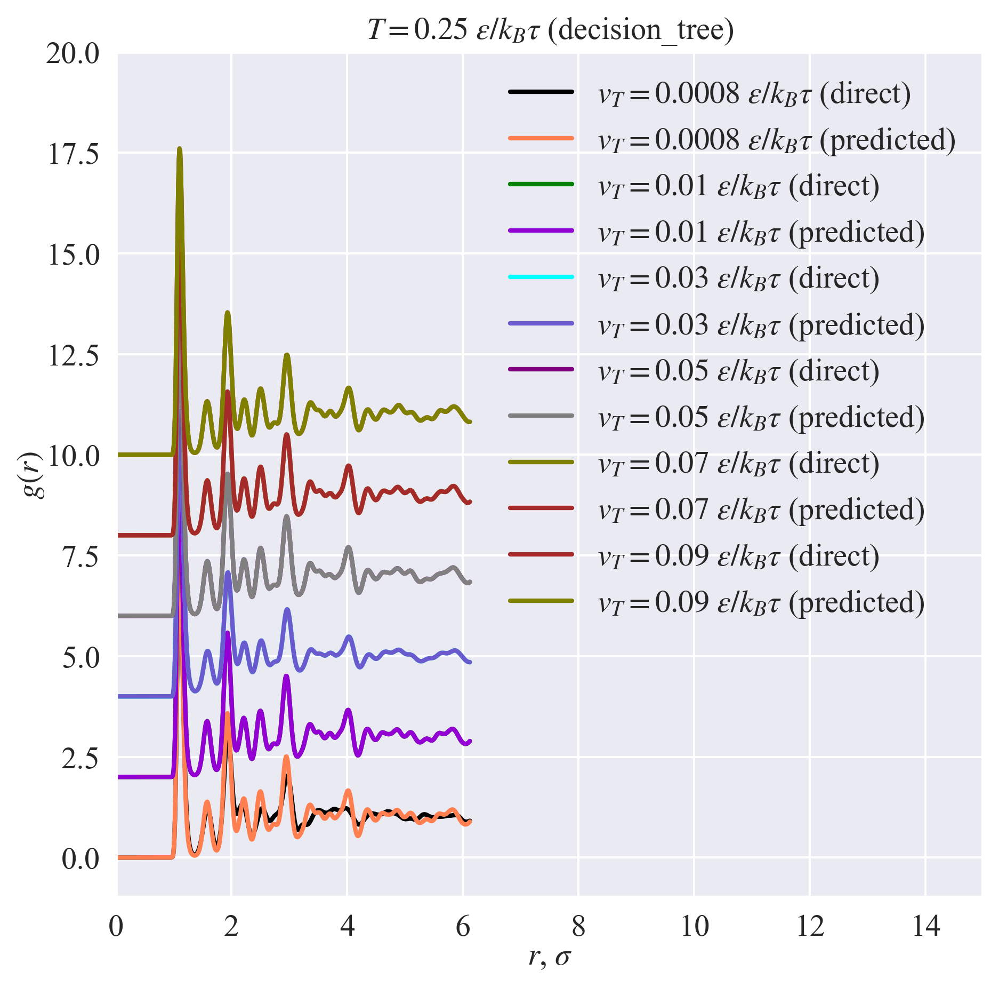

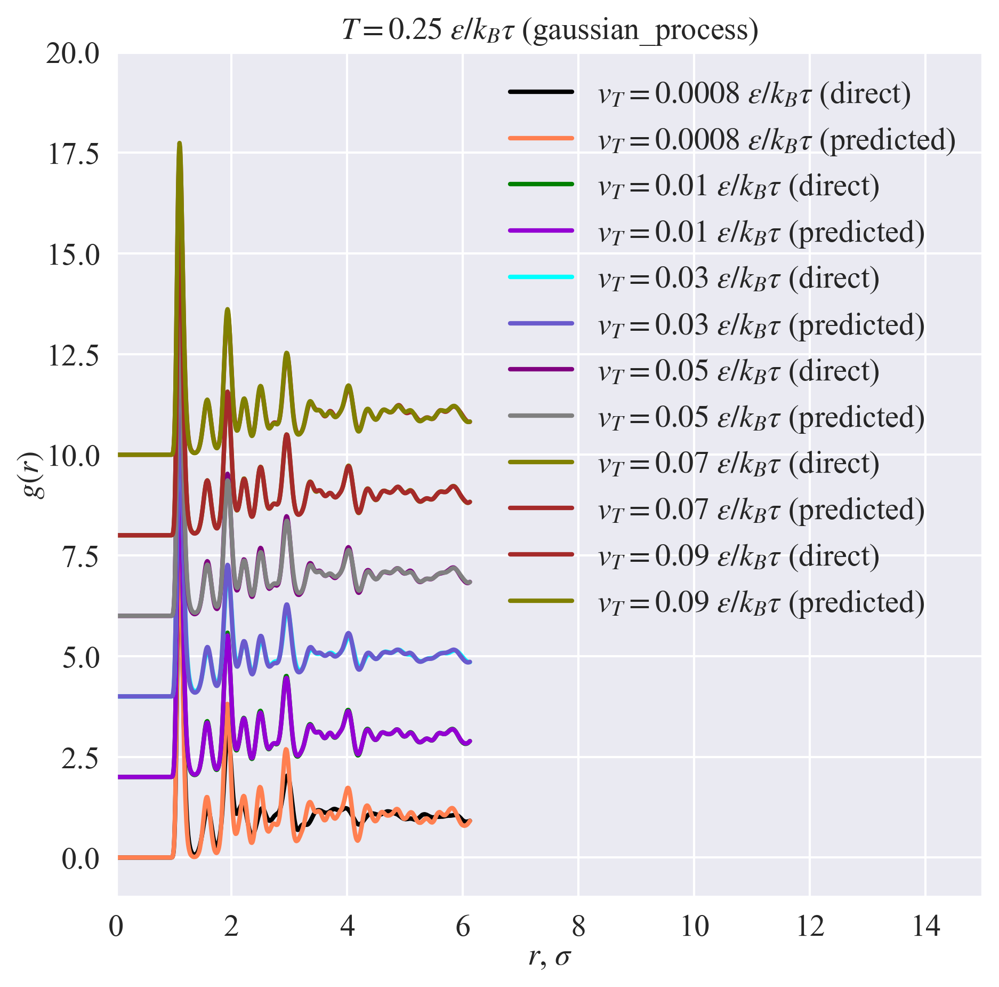

In [26]:
for temperature, rr in rr_dict.items():
    for key, value in predicted_rdf_points[temperature].items():
        fig, ax = plt.subplots(figsize=FIGSIZE,);
        for i, setup in enumerate(setups[temperature]):
            heating_velocity = setup["heating_velocity"]
            if heating_velocity not in test_heating_velocities:
                continue
            ax.plot(
                pp_dict[temperature].rdf.data['radius'],
                pp_dict[temperature].rdf.data[f'setup_{i}'] + i,
                label=fr'$v_T = {heating_velocity}~\epsilon / k_B\tau$ (direct)',
                color=COLORS[i],
            );
            ax.plot(
                rr.rdf_table.columns.values, 
                value[heating_velocity] + i,
                label=fr'$v_T = {heating_velocity}~\epsilon / k_B\tau$ (predicted)',
                color=COLORS[-i-1],
            );

        ax.set_xlabel('$r$, $\sigma$');
        ax.set_ylabel('$g(r)$');
        ax.set_xlim(
            left=0, 
            right=15,
        );
        ax.set_ylim(
            bottom=-1, 
            top=20,
        );
        ax.set_title(fr'$T = {temperature:.2f}~\varepsilon / k_B\tau$ ({key})');
        ax.legend();
        save_plot(f'rdf_with_predicted_cooling_{key}_{temperature}.png');
        plt.show();

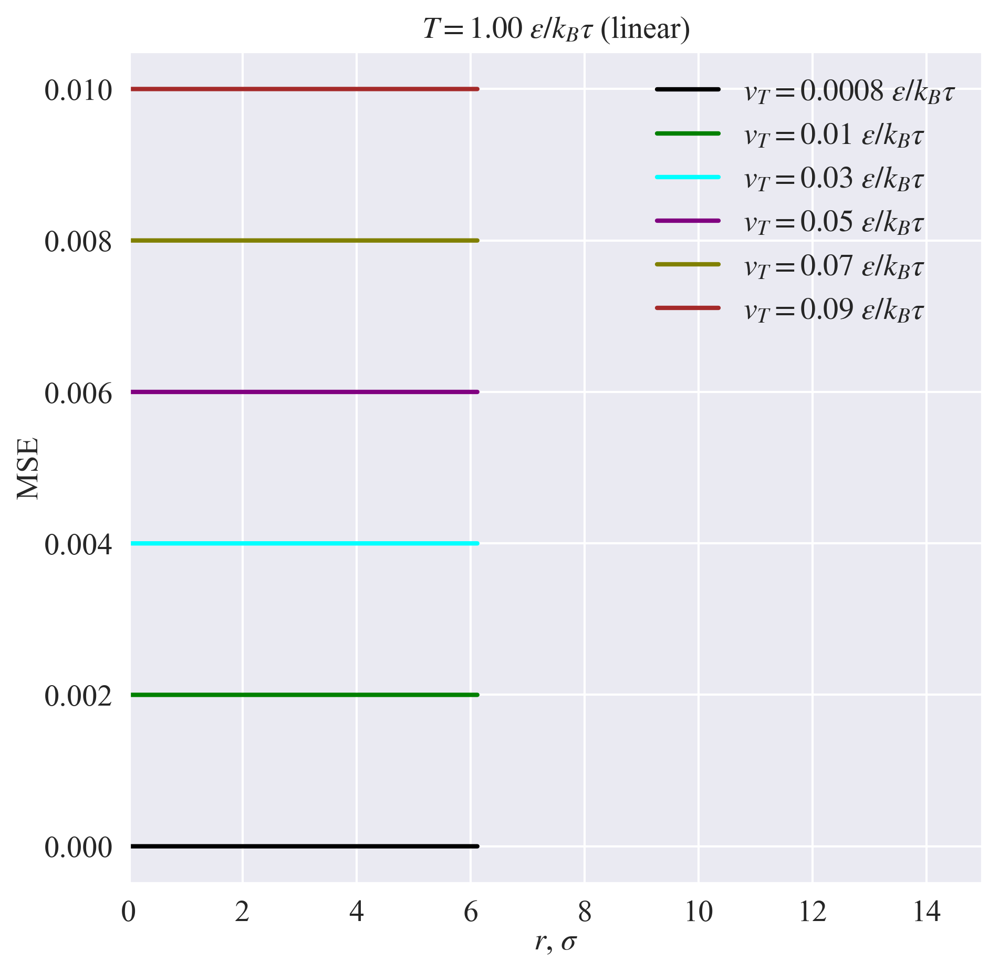

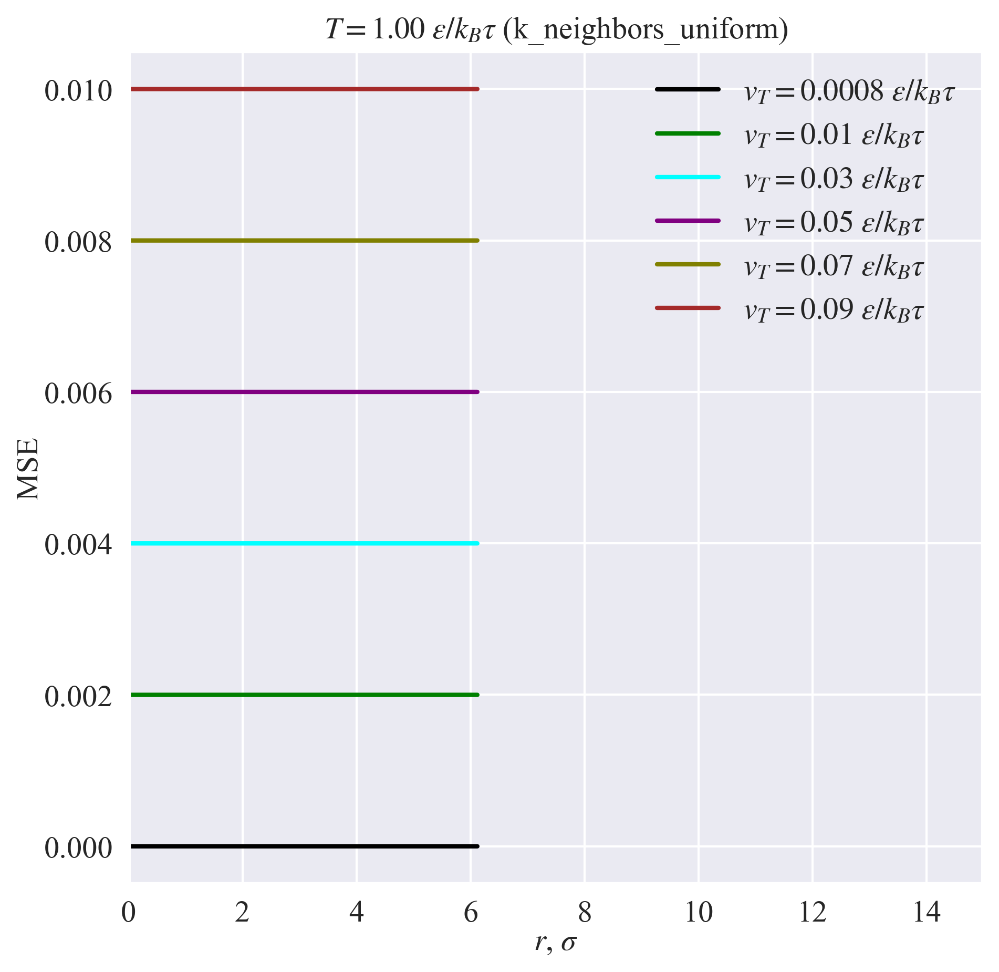

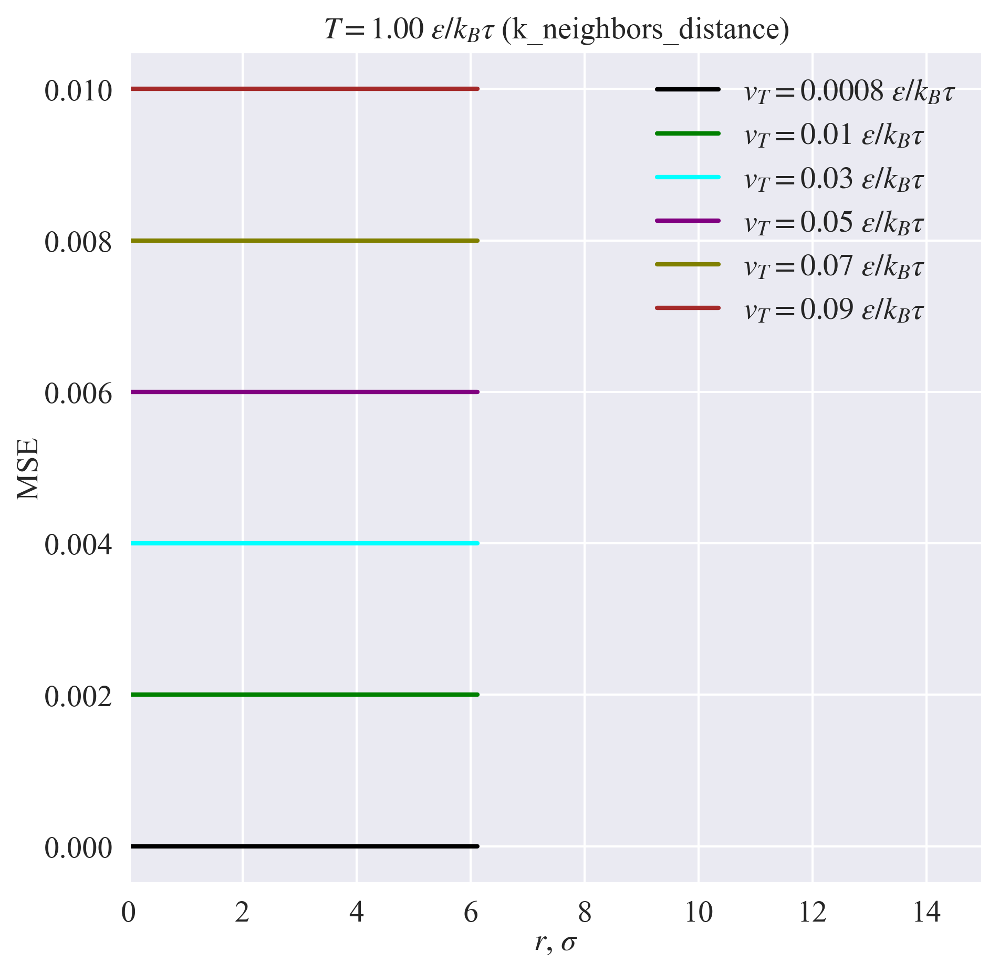

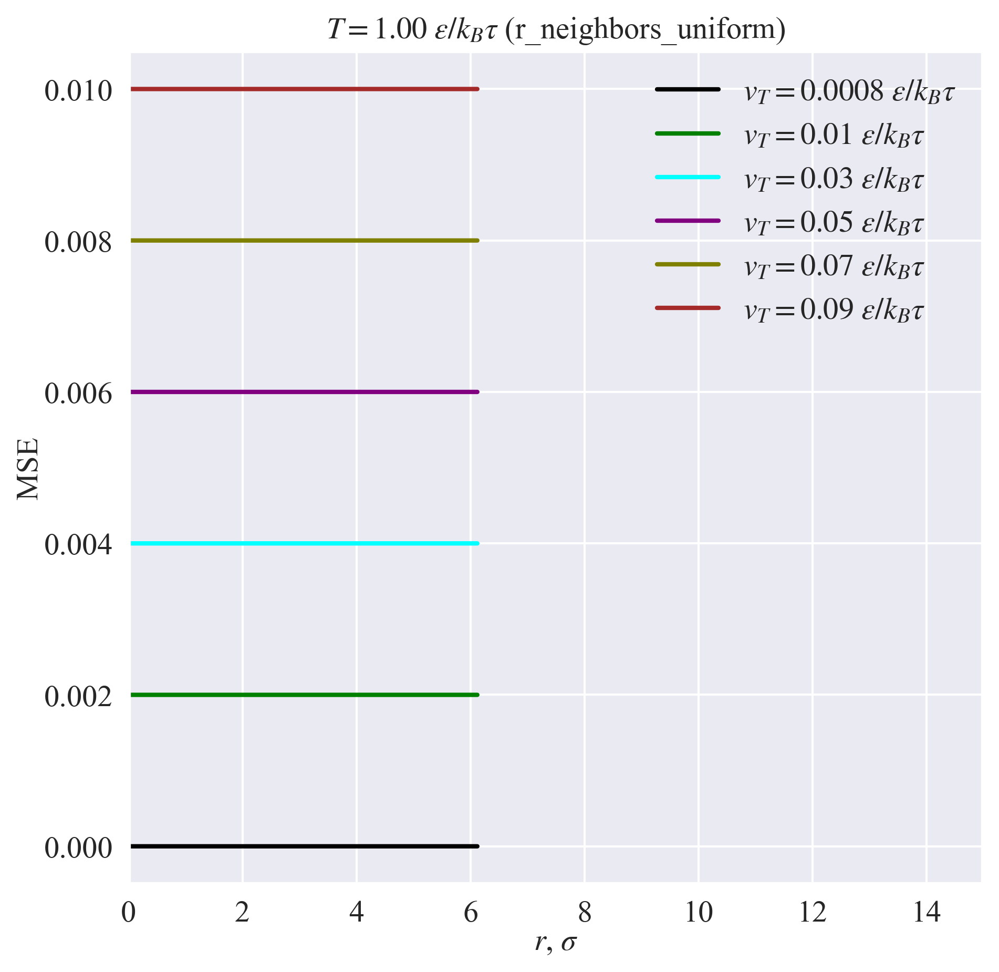

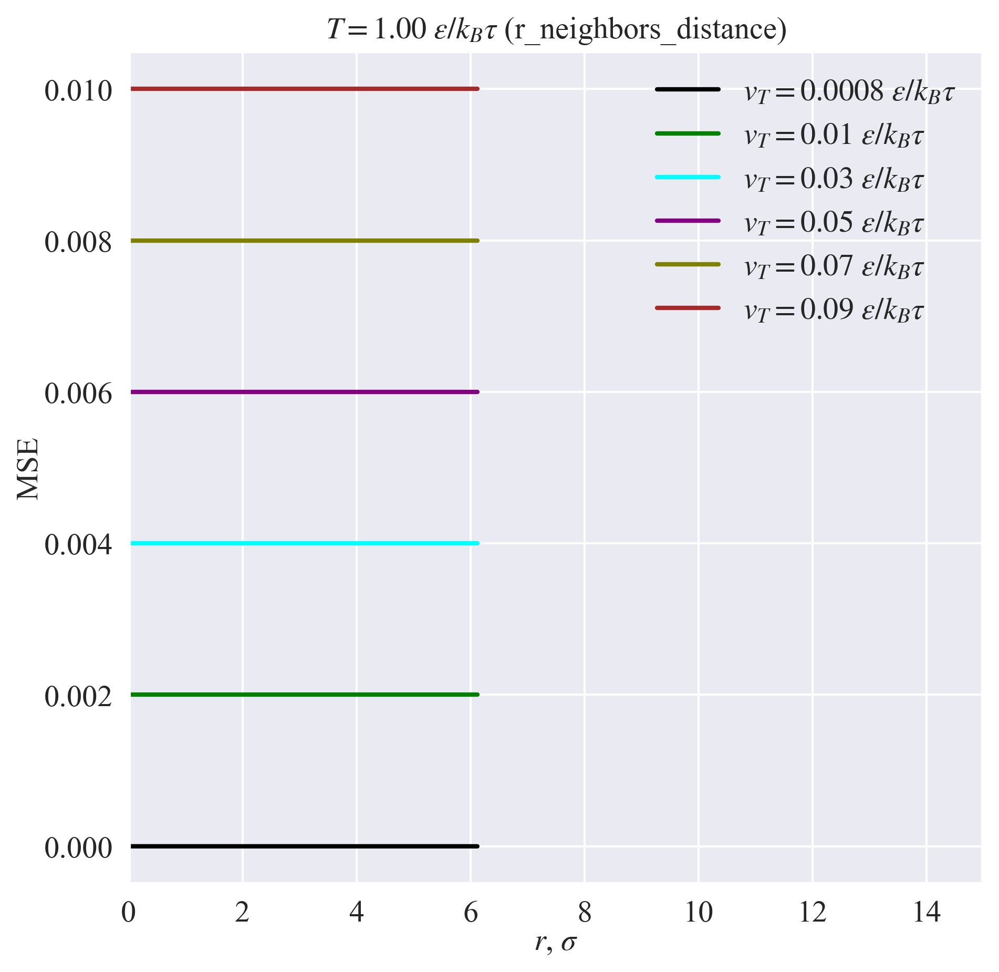

...

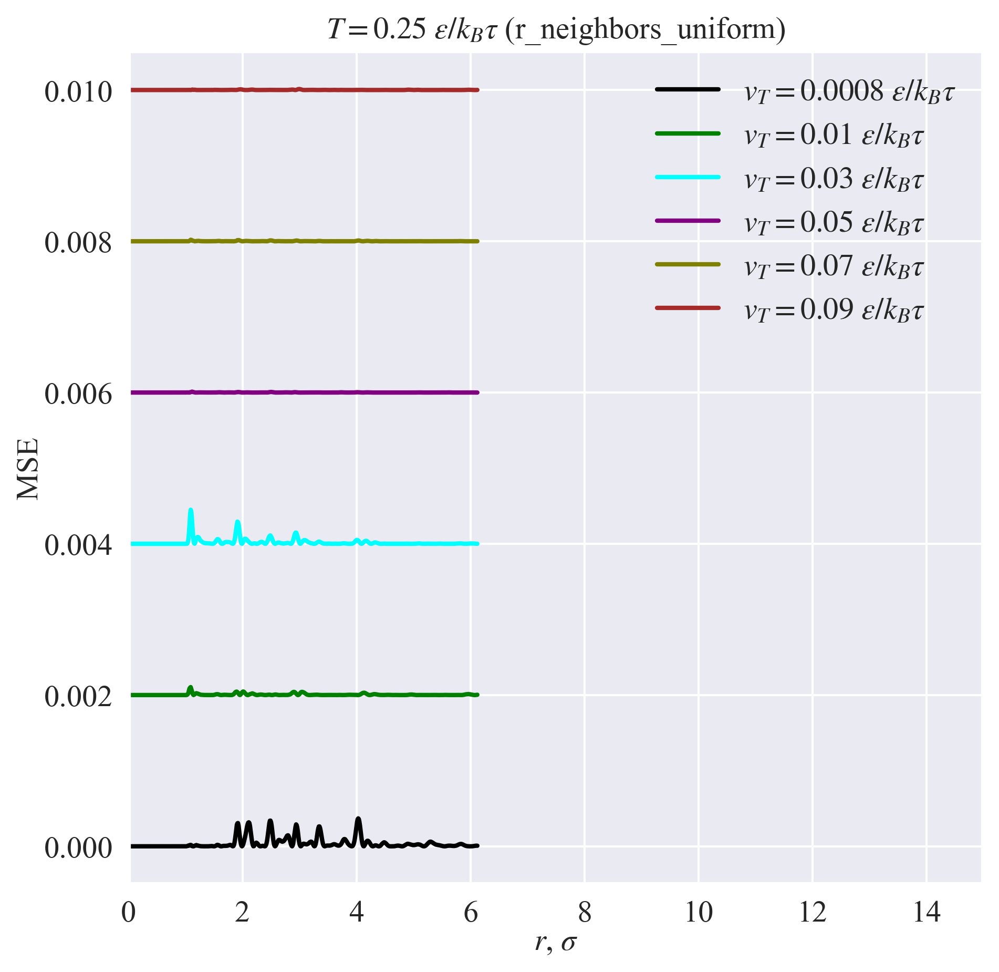

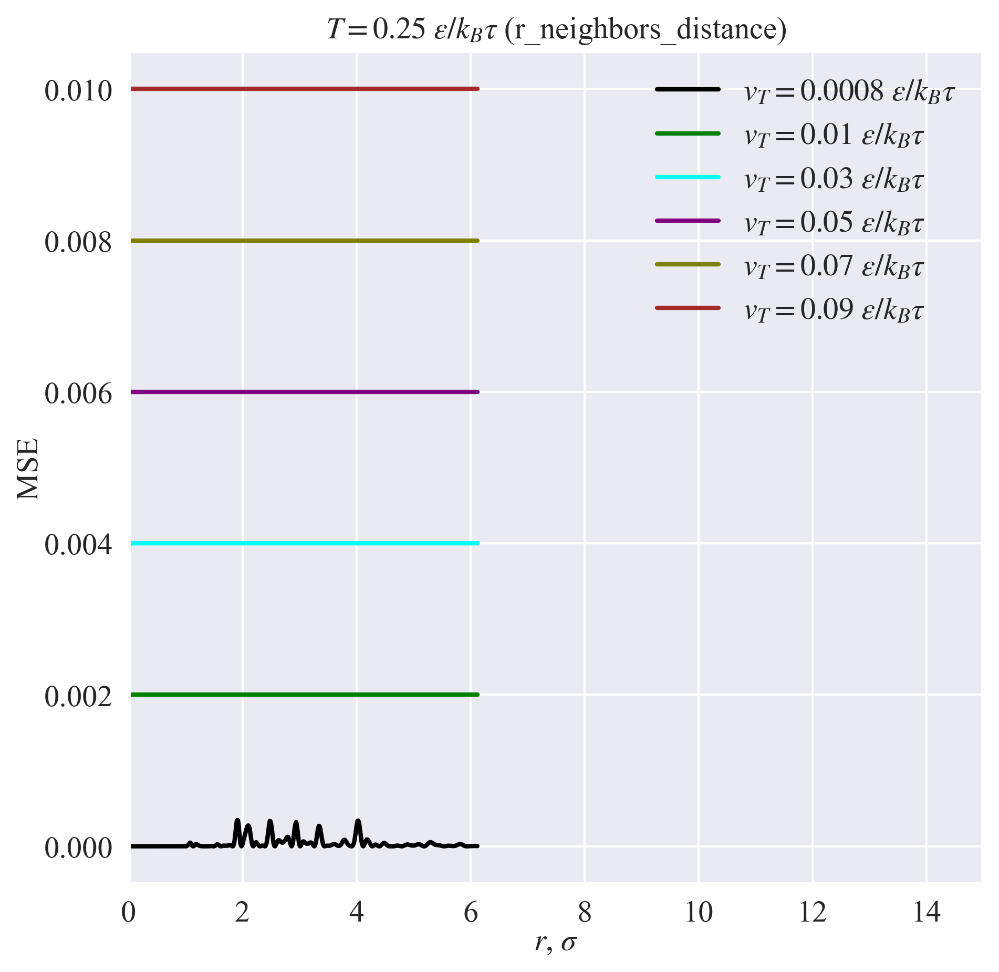

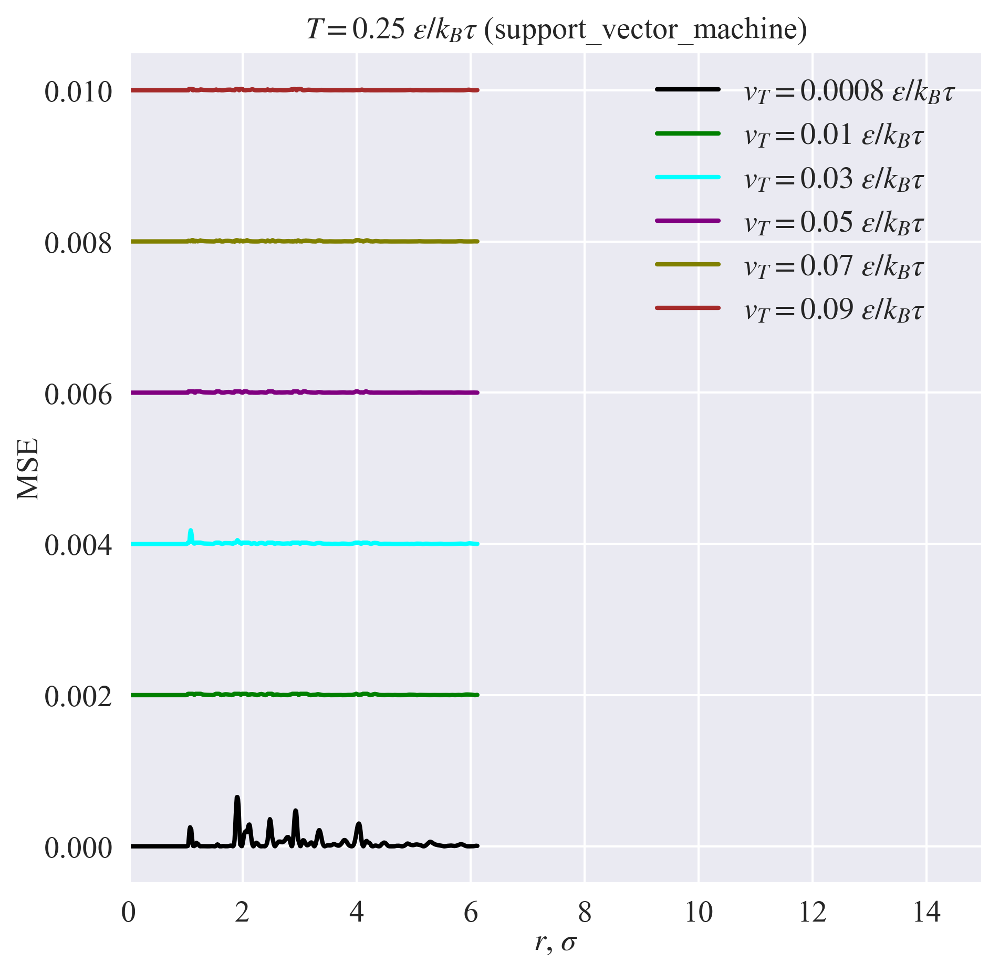

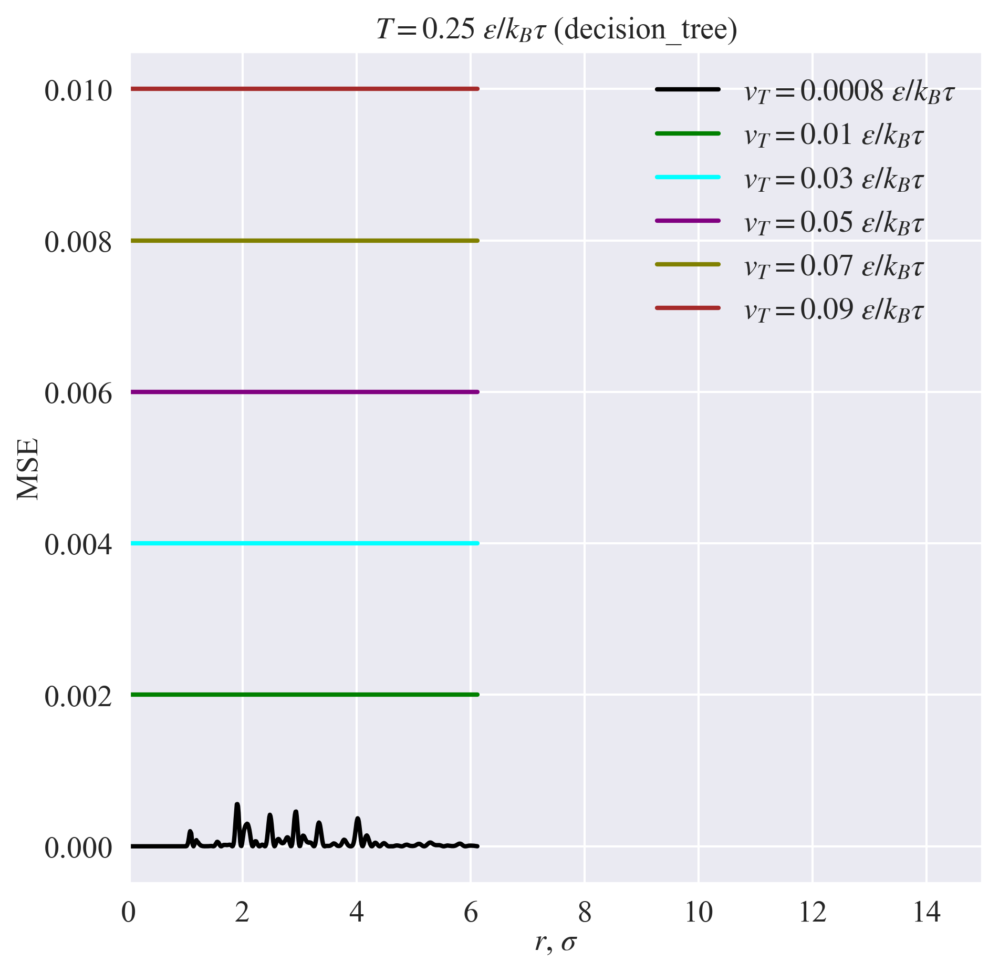

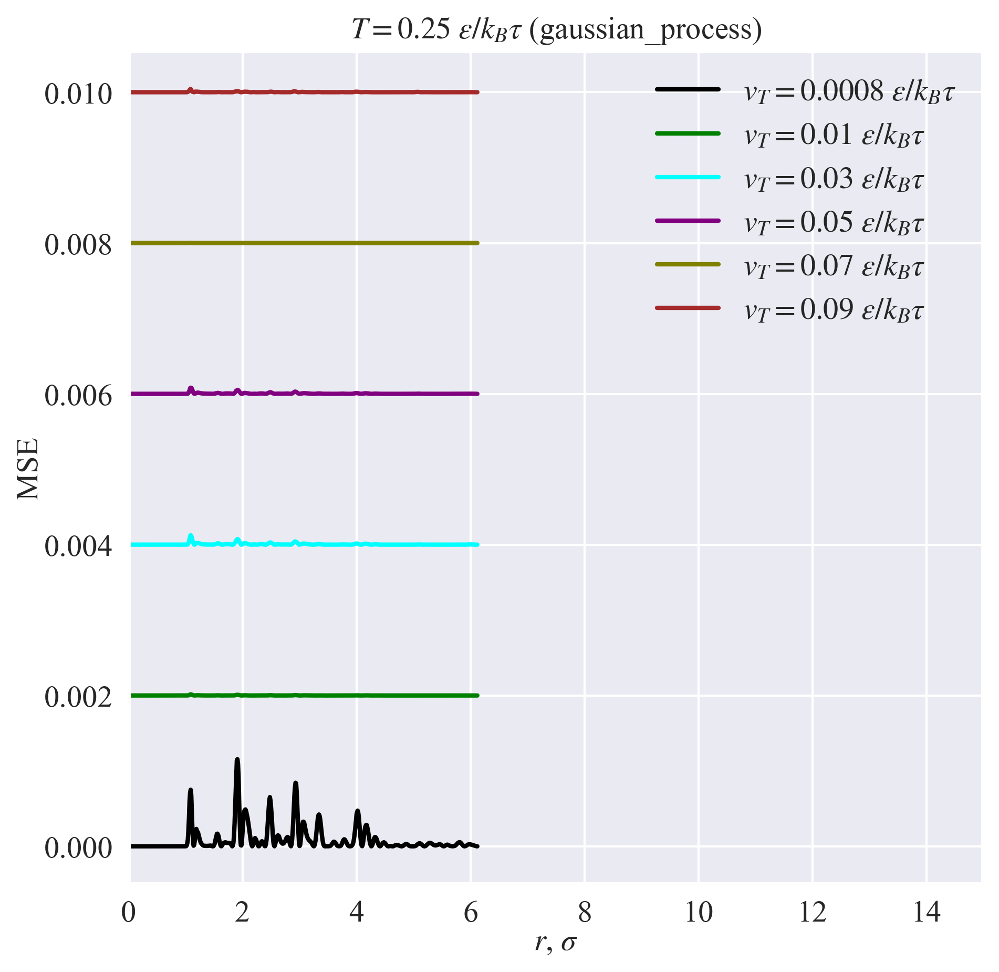

In [25]:
max_mse = {
    temperature: {
        'names': [],
    }
    for temperature, rr in rr_dict.items()
}

for temperature, rr in rr_dict.items():
    for key, value in predicted_rdf_points[temperature].items():
        name = ''.join([item[0].upper() for item in key.split('_')])
        max_mse[temperature]['names'].append(name)
        fig, ax = plt.subplots(figsize=FIGSIZE,);
        for i, setup in enumerate(setups[temperature]):
            heating_velocity = setup["heating_velocity"]
            if heating_velocity not in test_heating_velocities:
                continue
                
            mse = (
                value[heating_velocity] - pp_dict[temperature].rdf.data[f'setup_{i}']
            ) ** 2 / rr.rdf_table.columns.values.size
            try:
                max_mse[temperature][heating_velocity].append(mse.max())
            except KeyError:
                max_mse[temperature][heating_velocity] = [mse.max()]
            ax.plot(
                rr.rdf_table.columns.values, 
                mse + 0.001 * i,
                label=fr'$v_T = {heating_velocity}~\epsilon / k_B\tau$',
                color=COLORS[i],
            );

        ax.set_xlabel('$r$, $\sigma$');
        ax.set_ylabel('MSE');
        ax.set_xlim(
            left=0, 
            right=15,
        );
        ax.set_ylim(
    #         bottom=-1, 
    #         top=0.025,
        );
        ax.set_title(fr'$T = {temperature:.2f}~\varepsilon / k_B\tau$ ({key})');
        ax.legend();
        save_plot(f'rdf_mse_cooling_{key}_{temperature}.png');
        plt.show();

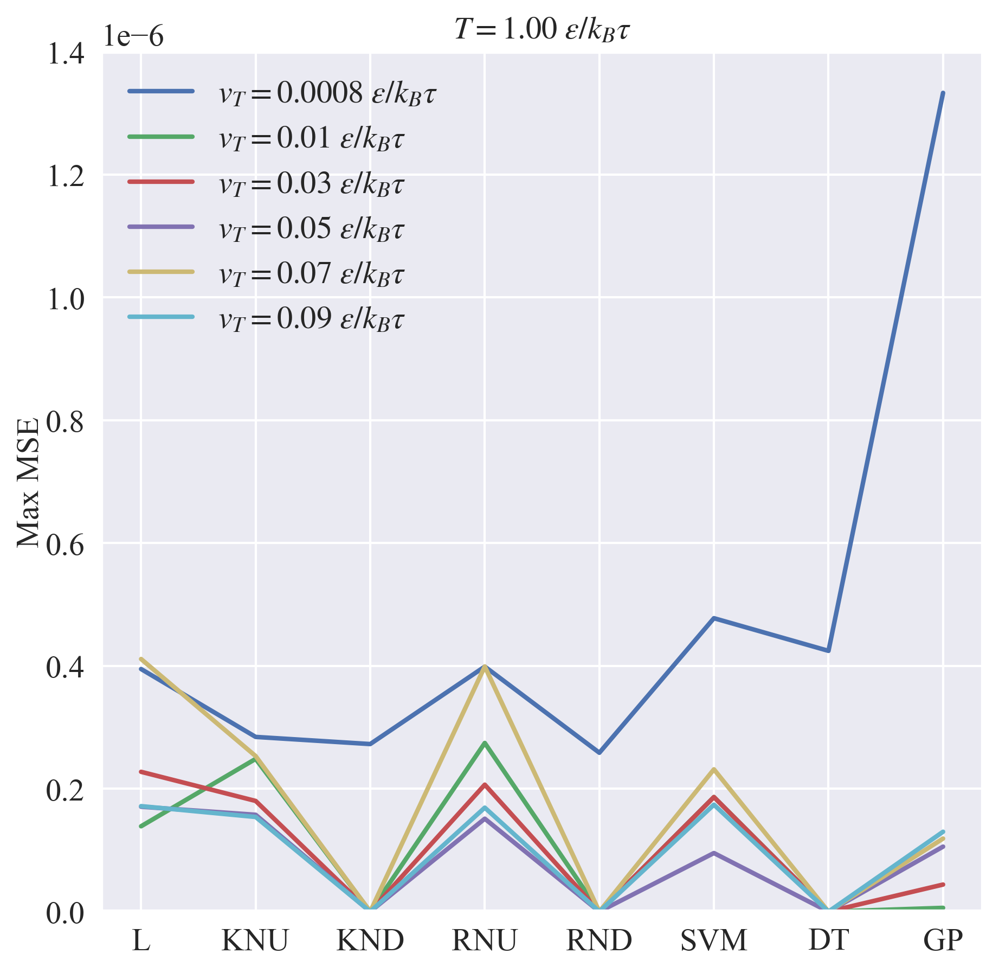

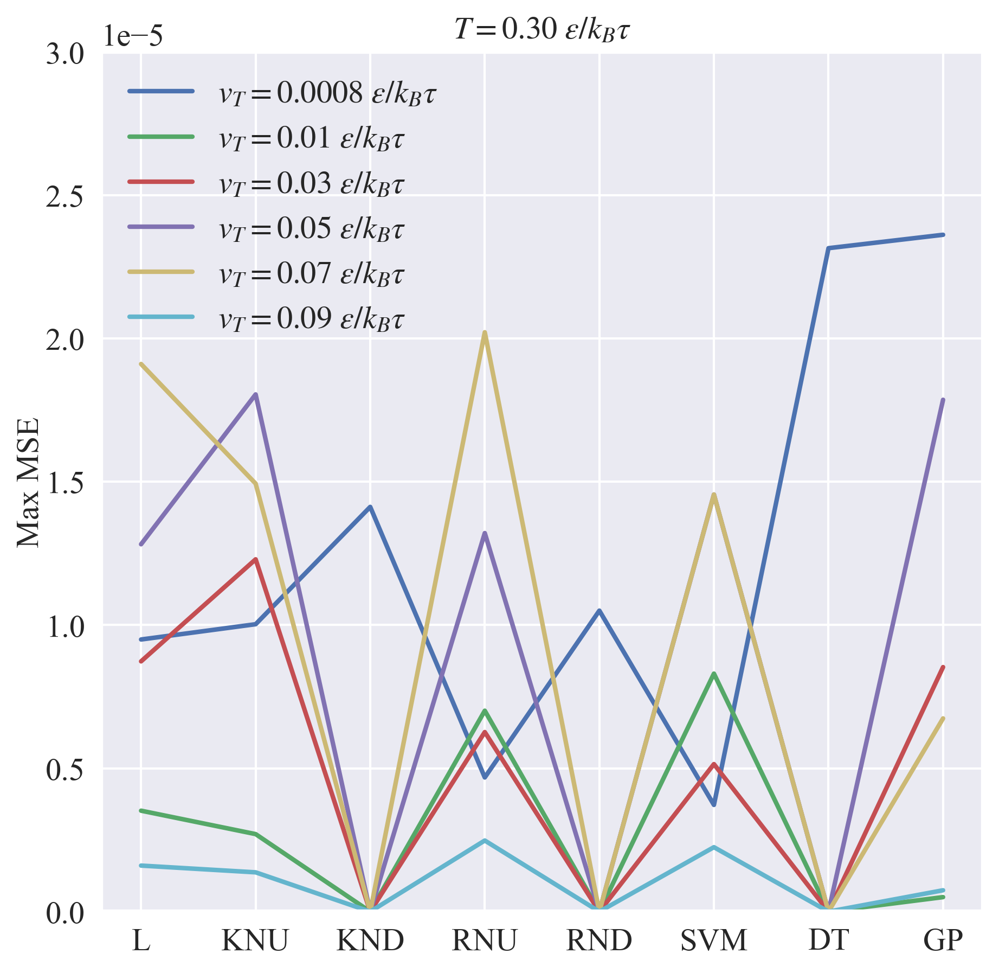

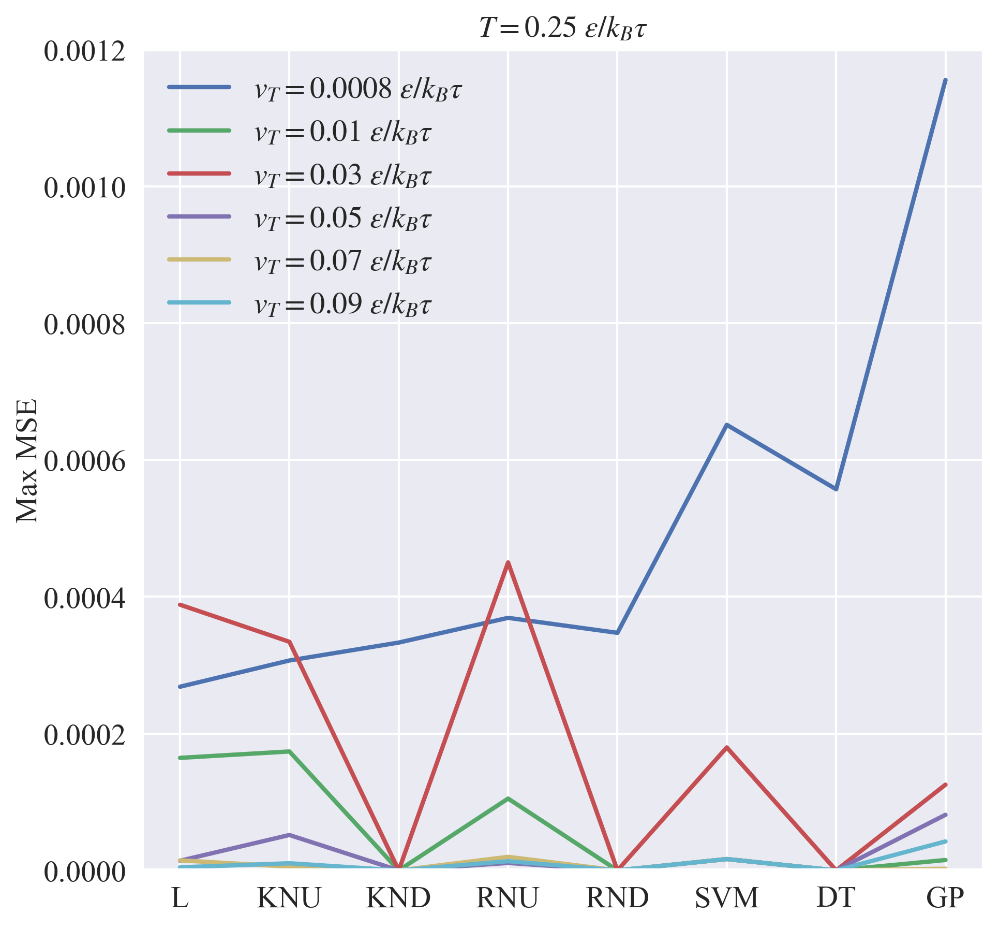

In [24]:
tops={
    1.00: 1.4e-6,
    0.95: 1.4e-6,
    0.30: 3.0e-5,
    0.25: 0.0012,
}

for temperature, item in max_mse.items():
    fig, ax = plt.subplots(figsize=FIGSIZE,);
    for heating_velocity, values in item.items():
        if isinstance(heating_velocity, float):
            x = list(range(len(values)))
            ax.plot(x, values, label=fr'$v_T = {heating_velocity}~\epsilon / k_B\tau$',);
            ax.set_xticks(x)
            ax.set_xticklabels(max_mse[temperature]['names'])
            ax.set_ylabel('Max MSE');
            ax.set_title(fr'$T = {temperature:.2f}~\varepsilon / k_B\tau$')
            ax.set_ylim(
                bottom=0, 
                top=tops[temperature],
            );
            ax.legend();
            save_plot(f'max_mse_{temperature}.png');